#Cuantizacion por canales de colores



El presente cuaderno tiene por objetivo explorar la cuantizacion  no solo en escala de grises sino en su efecto en los distintos canales de colores BRG

##Importacion de Librerias y obtención de Imagen


In [ ]:
import numpy as np
import cv2
from cv2 import imread
import matplotlib.pyplot as plt

--2025-04-10 18:11:14--  https://www2.eecs.berkeley.edu/Research/Projects/CS/vision/bsds/BSDS300/html/images/plain/normal/color/198023.jpg
Resolving www2.eecs.berkeley.edu (www2.eecs.berkeley.edu)... 128.32.244.190
Connecting to www2.eecs.berkeley.edu (www2.eecs.berkeley.edu)|128.32.244.190|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 39350 (38K) [image/jpeg]
Saving to: ‘198023.jpg.3’

198023.jpg.3        100%[===================>]  38.43K  --.-KB/s    in 0.05s   

2025-04-10 18:11:14 (794 KB/s) - ‘198023.jpg.3’ saved [39350/39350]



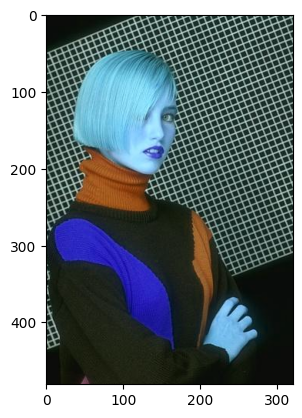

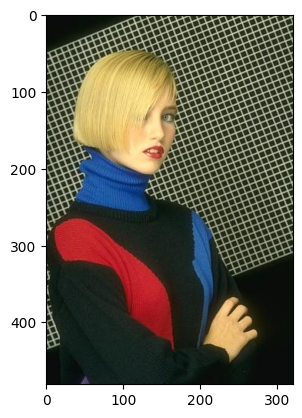

In [ ]:
!wget https://www2.eecs.berkeley.edu/Research/Projects/CS/vision/bsds/BSDS300/html/images/plain/normal/color/198023.jpg
imagen_original = imread('198023.jpg')
plt.imshow(imagen_original)
plt.show()
img_rgb=cv2.cvtColor(imagen_original,cv2.COLOR_BGR2RGB)
plt.imshow(img_rgb)

##Funciones utilizadas

In [ ]:
#Calcula devuelve 1 canal en grises obtenido con el promedio de los 3 canales
def convertirGrises(imagen):
    pixeles=np.mean(imagen,axis=2)
    return pixeles.astype(np.uint8)

In [ ]:
#Reduce los tonos de la imagen
def reducirTonos(matriz, tonos):

    # Calcular el factor de escala
    factor_escala = 255 / (tonos - 1) if tonos > 1 else 1

    # Iterar sobre la matriz y reescalar los valores
    for i in range(matriz.shape[0]):
        for j in range(matriz.shape[1]):
            nuevo_valor = int(round(matriz[i, j] / factor_escala) * factor_escala)
            matriz[i, j] = np.clip(nuevo_valor, 0, 255)  # Asegurar que los valores estén en el rango 0-255

    return matriz

In [ ]:
#Devuelve una imagen de 3 canales donde se reducen los tonos de cada canal de forma separada
def reduceCanales(imagen,tonos):
    imagen_R=imagen[:,:,2]
    imagen_G=imagen[:,:,1]
    imagen_B=imagen[:,:,0]
    imagen_R=reducirTonos(imagen_R.copy(),tonos)
    imagen_G=reducirTonos(imagen_G.copy(),tonos)
    imagen_B=reducirTonos(imagen_B.copy(),tonos)
    imagen_bgr=np.dstack((imagen_B,imagen_G,imagen_R))
    return imagen_bgr

In [ ]:
#Muestra la imagen encolor, en 3 canales en grises, en 1 solo canal en grises y los canales en forma separada
def MuestraCanales(imagen,tonos=256):

    #Muestra la imagen en colores y en grises
    img_gris_canales=convertirGrises(imagen.copy())
    img_gris=reducirTonos(convertirGrises(imagen_original.copy()),tonos)
    img_rgb=cv2.cvtColor(imagen,cv2.COLOR_BGR2RGB)
    fig, axes = plt.subplots(1, 3, figsize=(10, 5))
    axes[0].imshow(img_gris, cmap='gray')
    axes[0].axis('off')
    axes[0].set_title(f'1 canal de {tonos} tonos en grises')
    axes[1].imshow(img_gris_canales, cmap='gray')
    axes[1].axis('off')
    axes[1].set_title(f'{tonos} tonos por canal en grises')
    axes[2].imshow(img_rgb)
    axes[2].axis('off')
    axes[2].set_title(f'{tonos} tonos por canal en RGB')
    plt.tight_layout()
    plt.show()

    # Separar los canales de color y los muestra en color y en grises
    imagen_R=img_rgb[:,:,0]
    imagen_G=img_rgb[:,:,1]
    imagen_B=img_rgb[:,:,2]

    fig, axes = plt.subplots(2, 3, figsize=(10, 10))
    axes[0,0].imshow(imagen_R, cmap='Reds')
    axes[0,0].axis('off')
    axes[0,0].set_title(f'{tonos} tonos - Canal R')
    axes[0,1].imshow(imagen_G, cmap='Greens')
    axes[0,1].axis('off')
    axes[0,1].set_title(f'{tonos} tonos - Canal G')
    axes[0,2].imshow(imagen_B, cmap='Blues')
    axes[0,2].axis('off')
    axes[0,2].set_title(f'{tonos} tonos - Canal B')
    axes[1,0].imshow(imagen_R, cmap='gray')
    axes[1,0].axis('off')
    axes[1,0].set_title(f'{tonos} tonos - Canal R en Grises')
    axes[1,1].imshow(imagen_G, cmap='gray')
    axes[1,1].axis('off')
    axes[1,1].set_title(f'{tonos} tonos - Canal G en Grises')
    axes[1,2].imshow(imagen_B, cmap='gray')
    axes[1,2].axis('off')
    axes[1,2].set_title(f'{tonos} tonos - Canal B en grises')
    plt.tight_layout()
    plt.show()


    # Calcula el histograma para cada imagen
    hist_gris, bins_gris = np.histogram(img_gris, bins=256, range=(0, 256))
    hist_R, bins_R = np.histogram(imagen_R, bins=256, range=(0, 256))
    hist_G, bins_G = np.histogram(imagen_G, bins=256, range=(0, 256))
    hist_B, bins_B = np.histogram(imagen_B, bins=256, range=(0, 256))

    # Crea el gráfico con los histogramas
    fig, axes = plt.subplots(2, 2, figsize=(15, 5))

    axes[0,0].plot(bins_gris[:-1], hist_gris, color='black', label='Gris', alpha=0.5)
    axes[0,0].legend()  # Muestra la leyenda para identificar cada histograma

    axes[0,1].plot(bins_R[:-1], hist_R, color='red', label='Rojo', alpha=0.5)
    axes[0,1].legend()  # Muestra la leyenda para identificar cada histograma

    axes[1,0].plot(bins_G[:-1], hist_G, color='green', label='Verde', alpha=0.5)
    axes[1,0].legend()  # Muestra la leyenda para identificar cada histograma

    axes[1,1].plot(bins_B[:-1], hist_B, color='blue', label='Azul', alpha=0.5)
    axes[1,1].legend()  # Muestra la leyenda para identificar cada histograma
    plt.tight_layout()
    plt.show()


##Pruebas con distintos valores de tonos


###############################
  Imagen con 256 tonos      
###############################



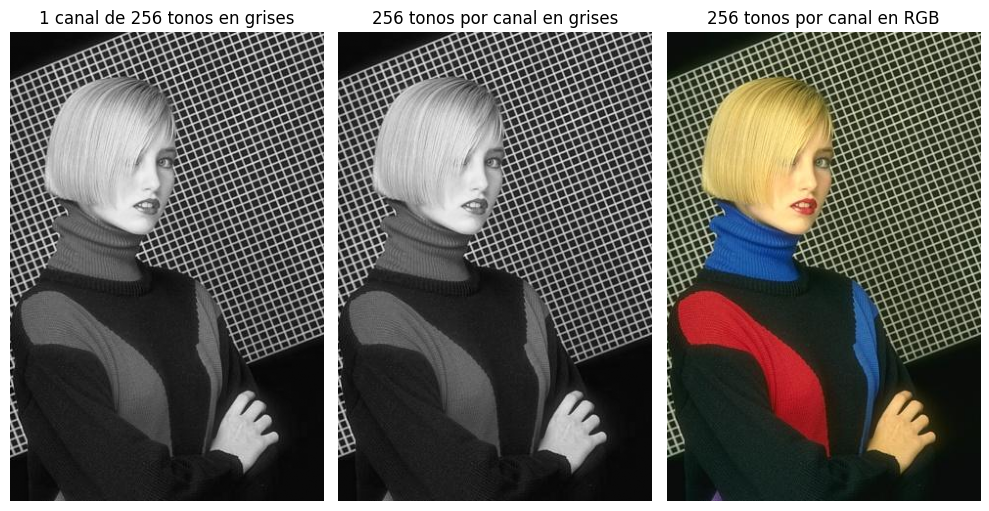

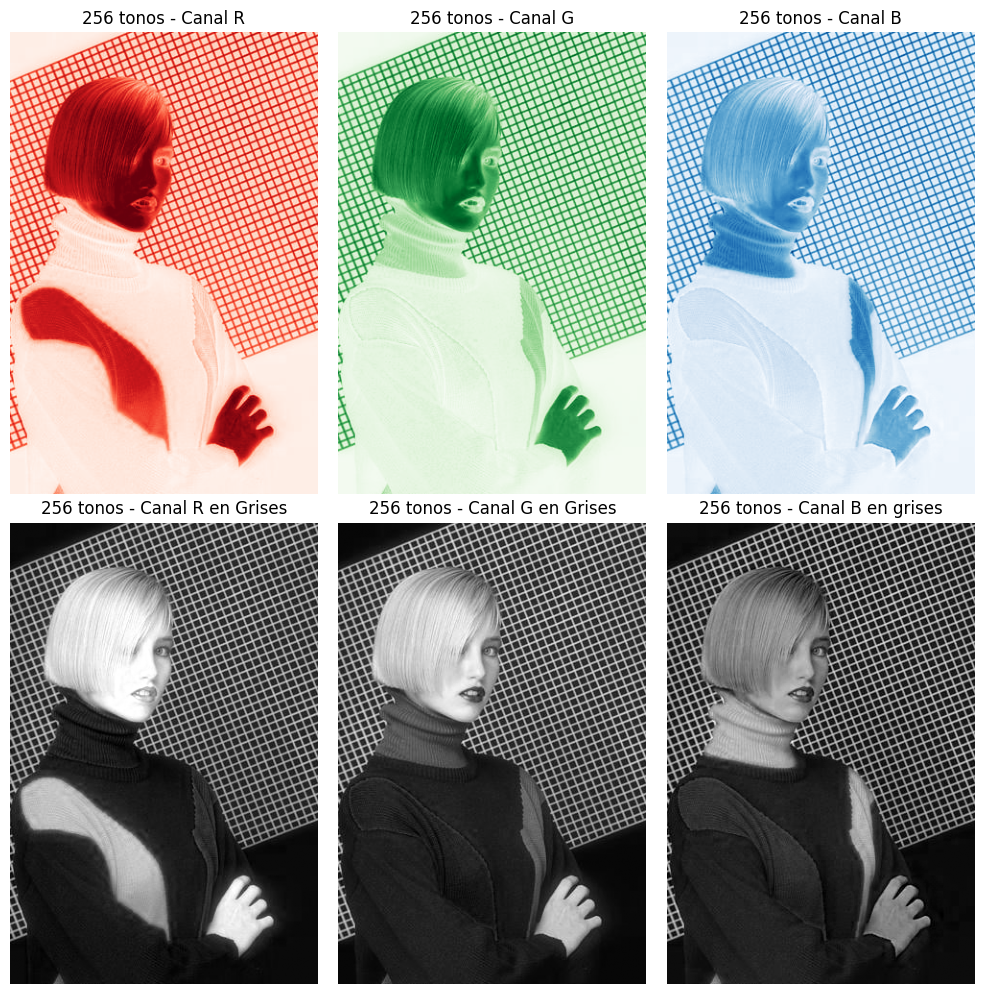

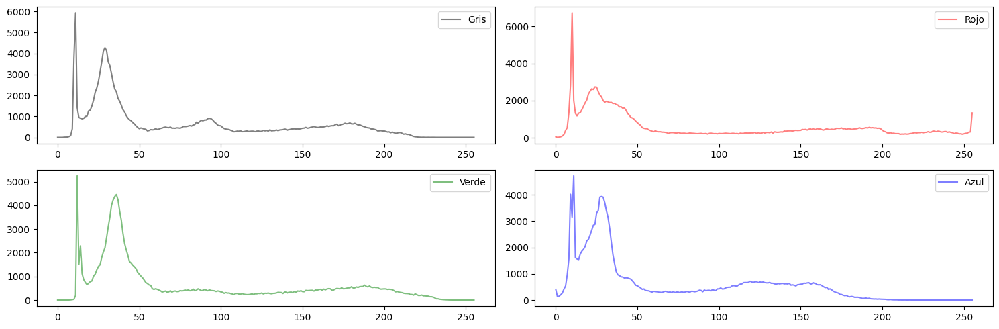


###############################
  Imagen con 128 tonos      
###############################



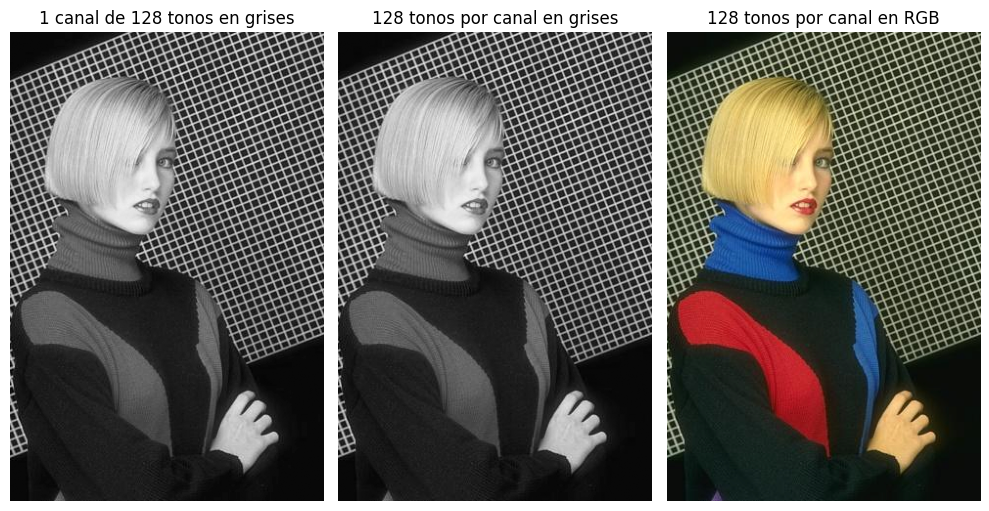

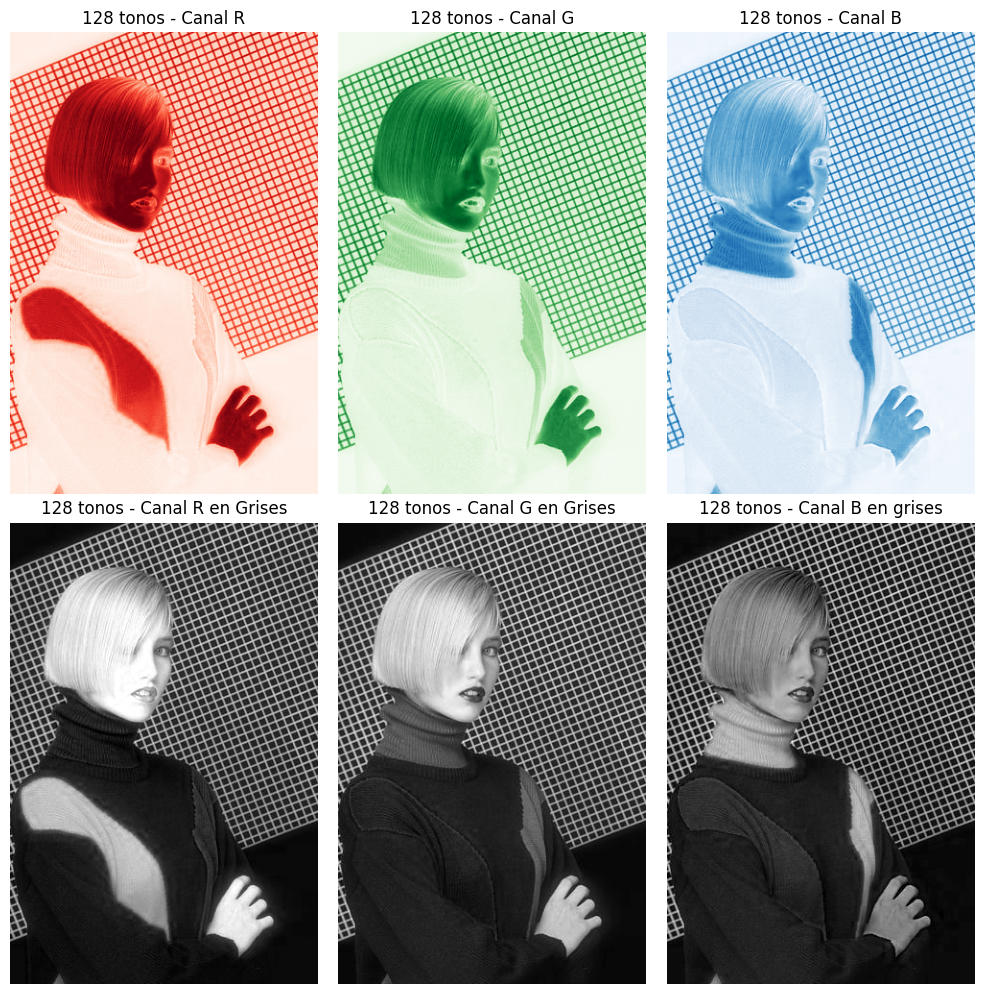

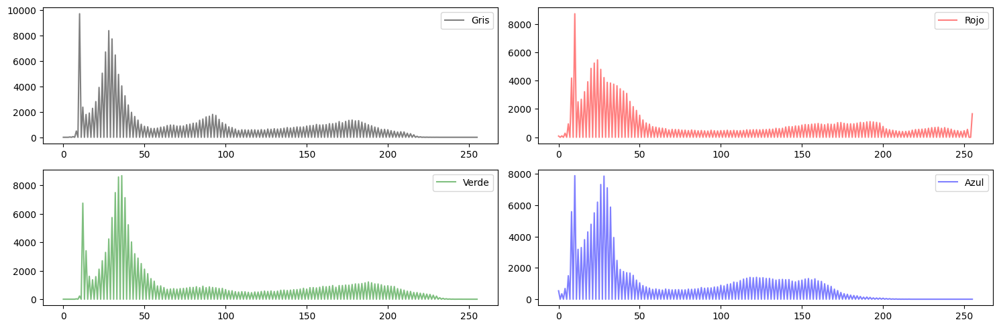


###############################
  Imagen con 64 tonos      
###############################



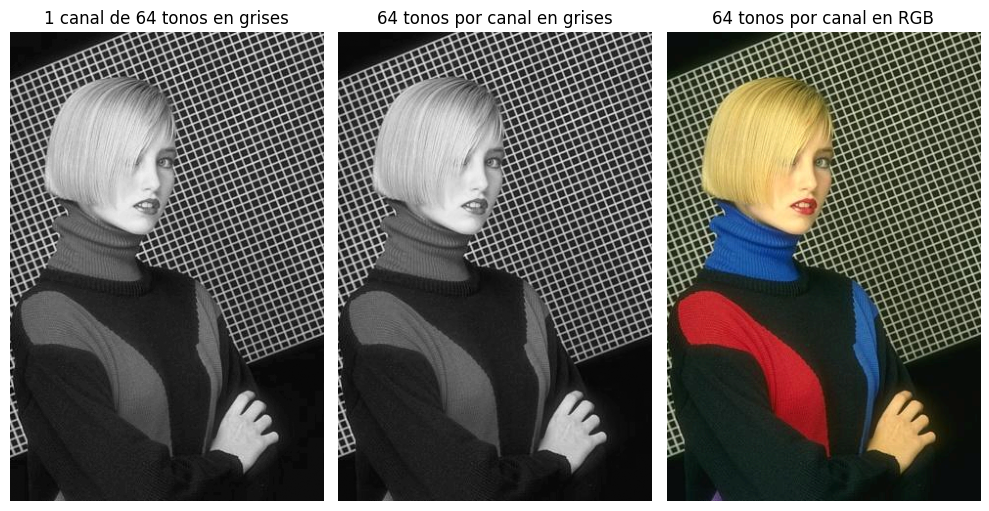

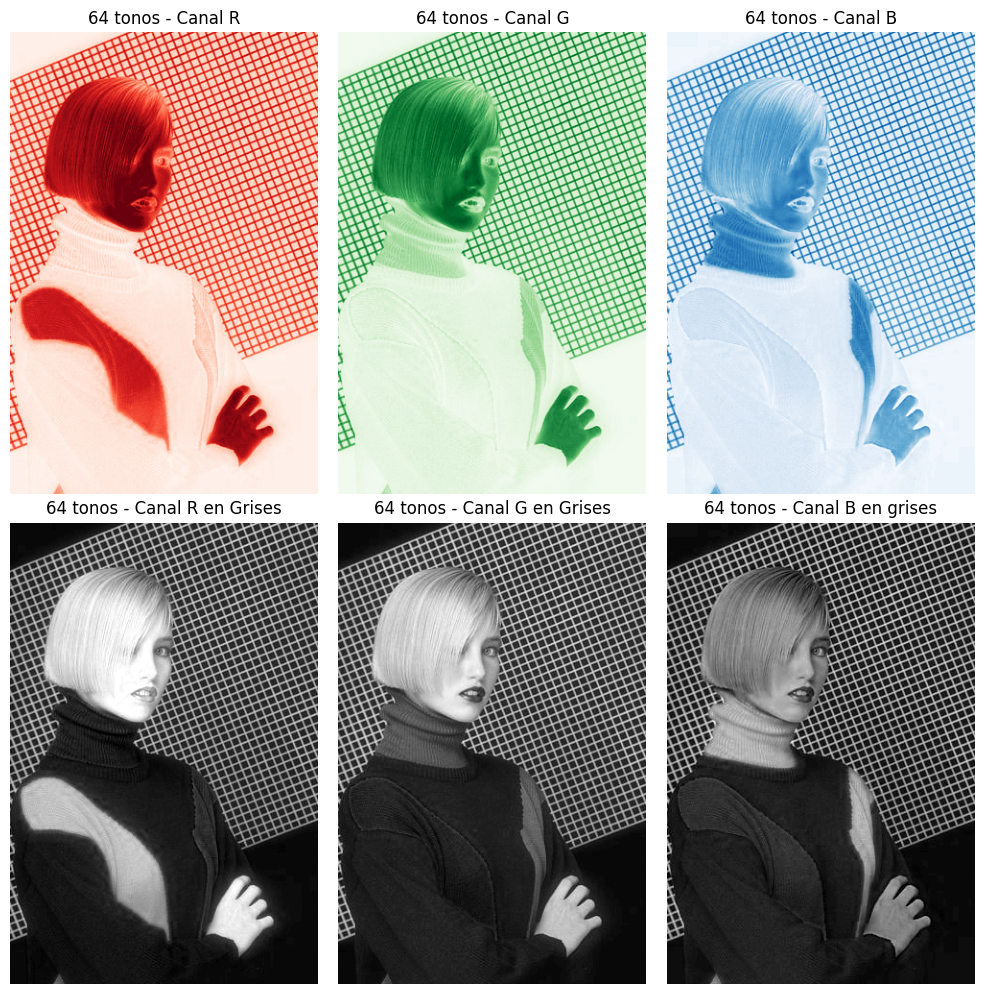

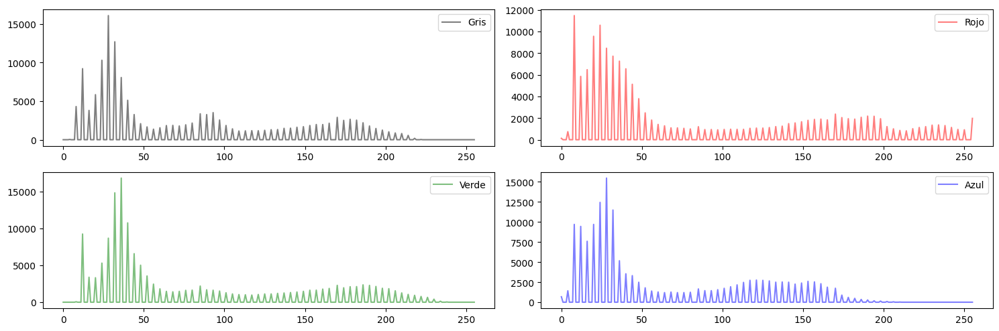


###############################
  Imagen con 32 tonos      
###############################



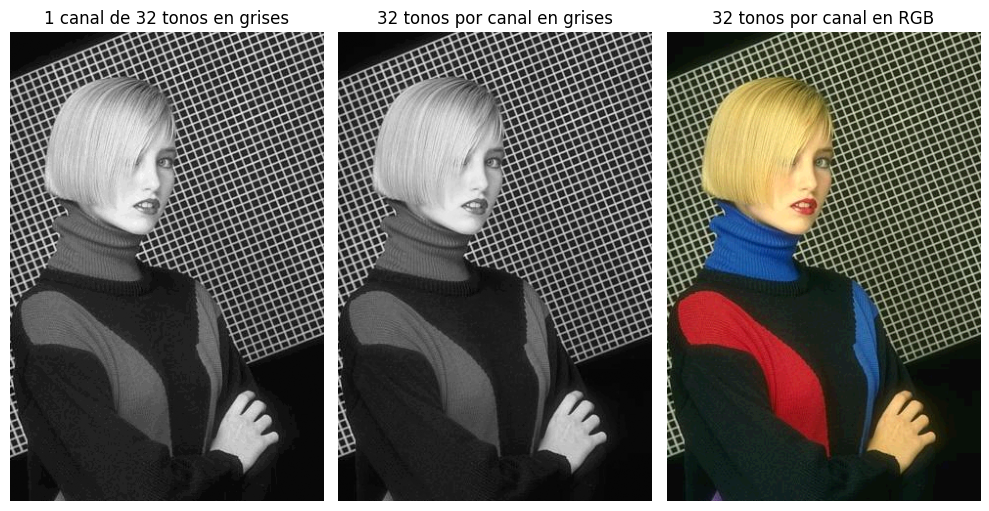

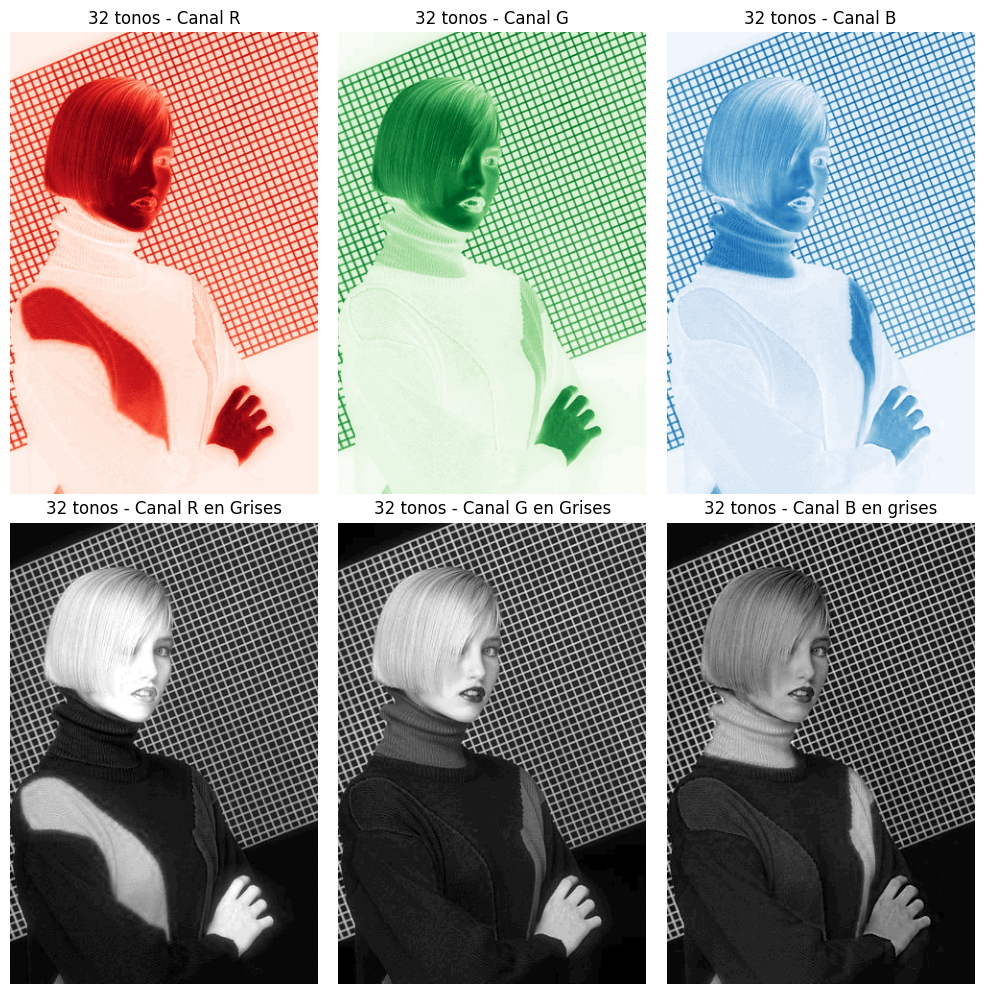

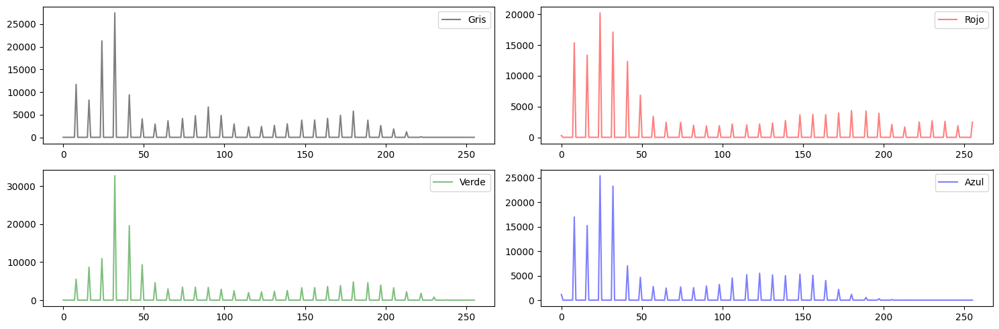


###############################
  Imagen con 16 tonos      
###############################



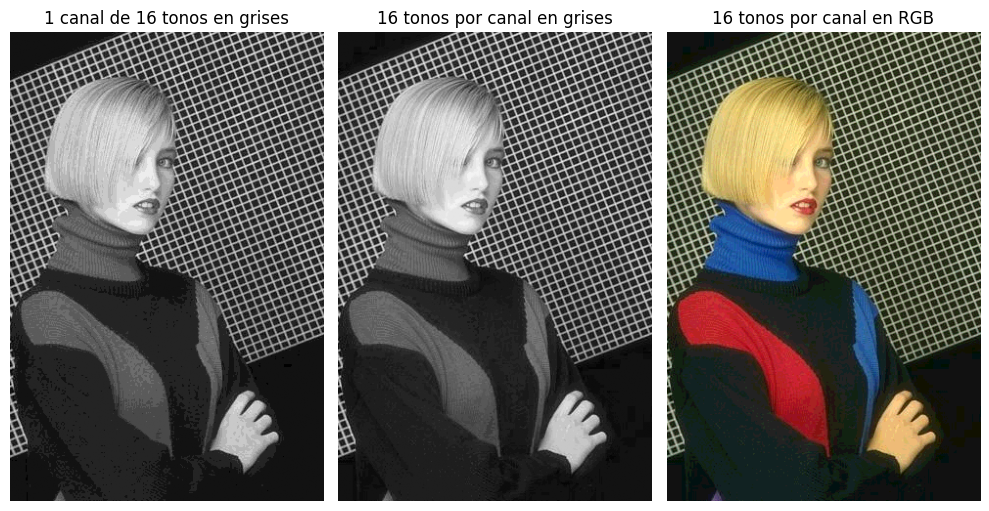

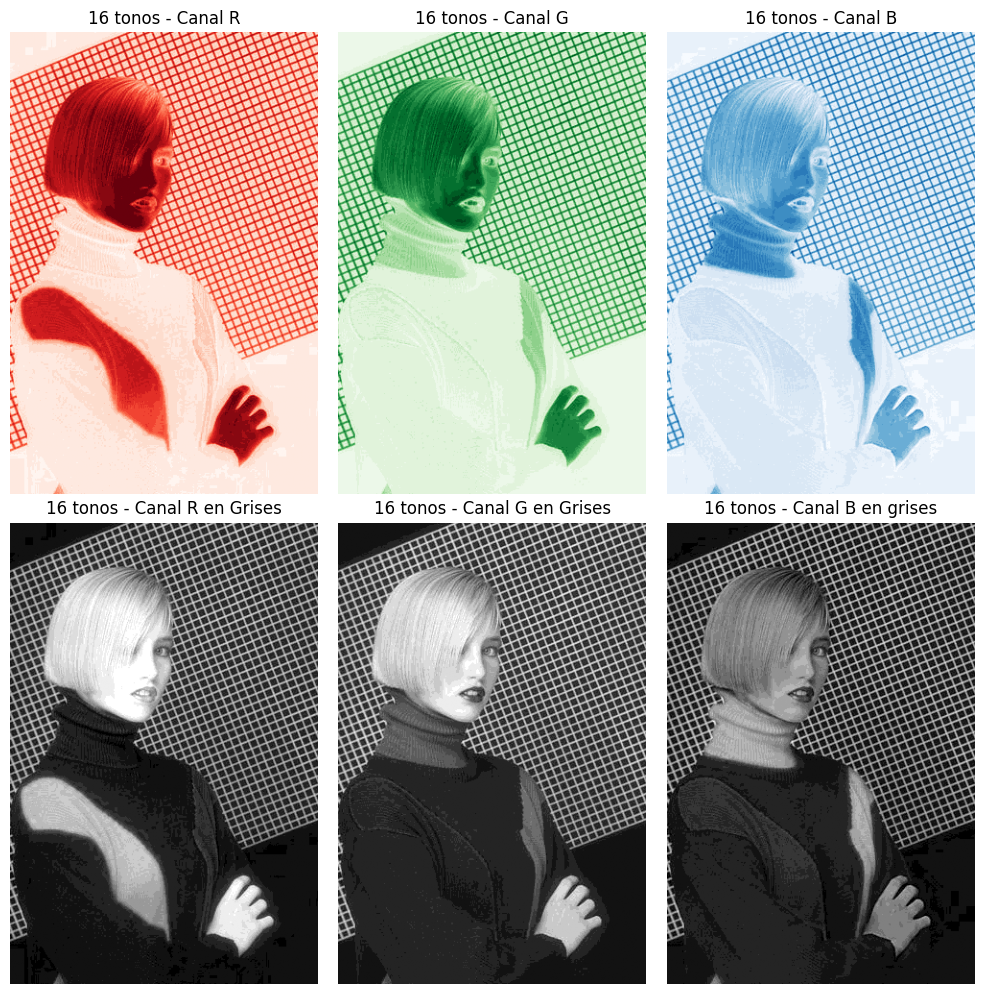

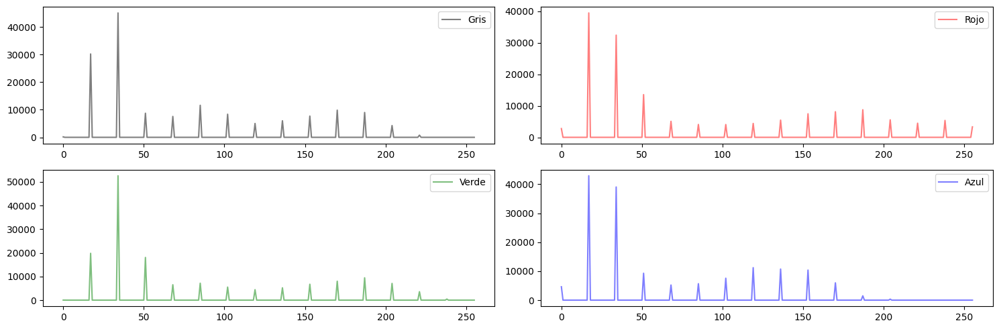


###############################
  Imagen con 8 tonos      
###############################



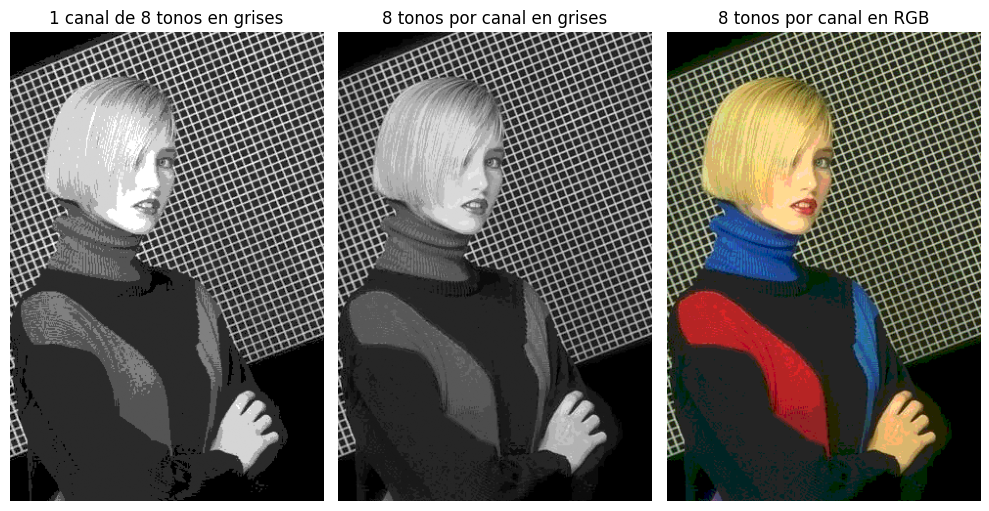

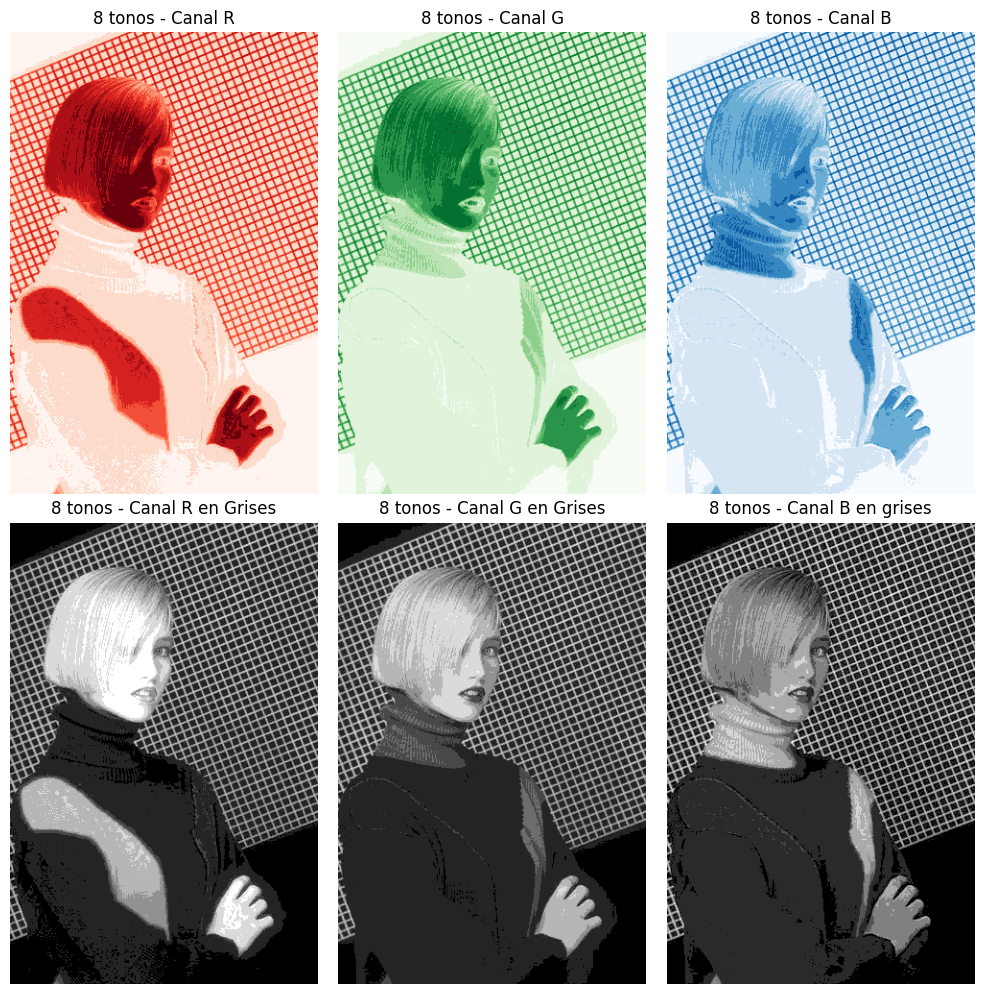

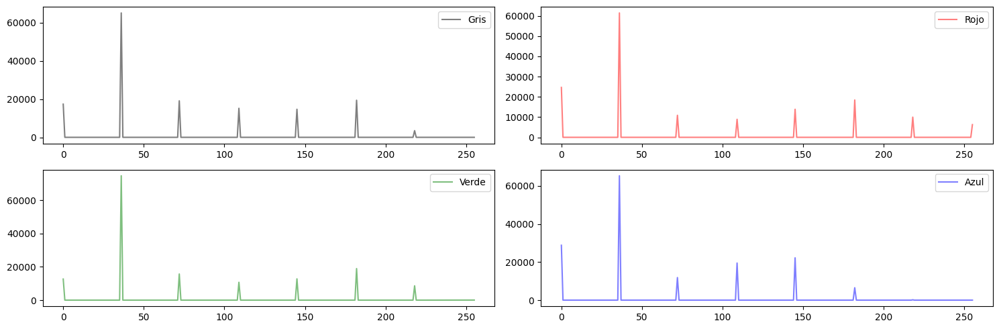


###############################
  Imagen con 4 tonos      
###############################



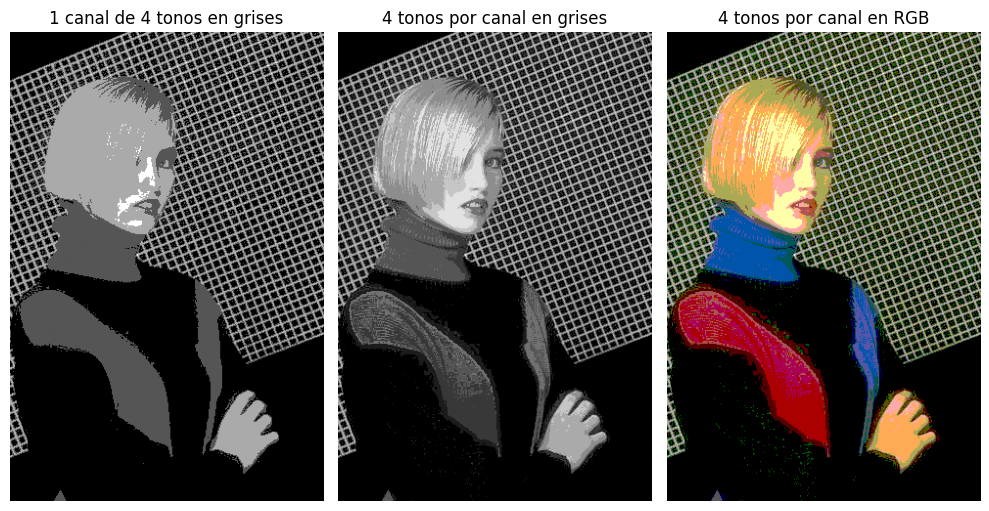

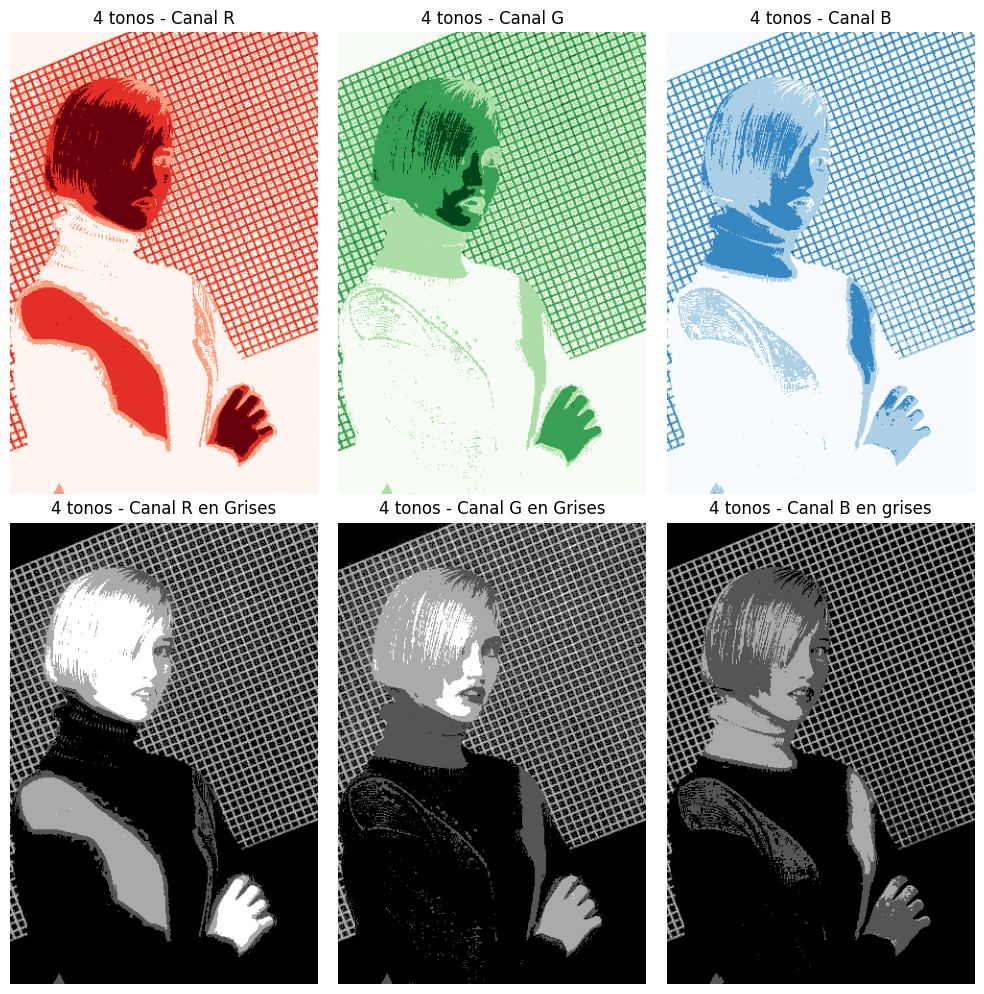

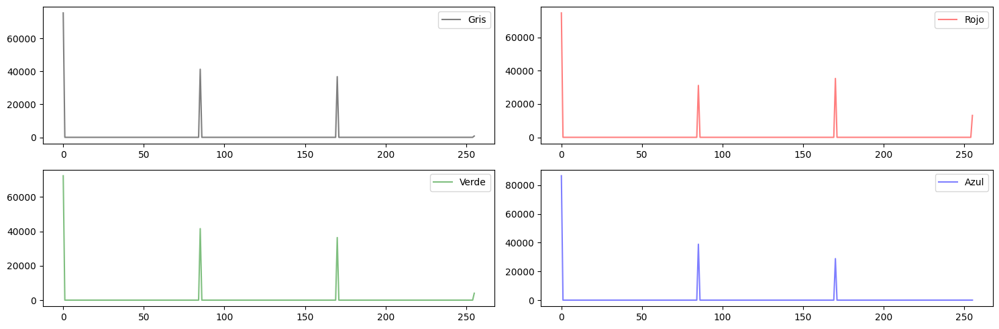


###############################
  Imagen con 2 tonos      
###############################



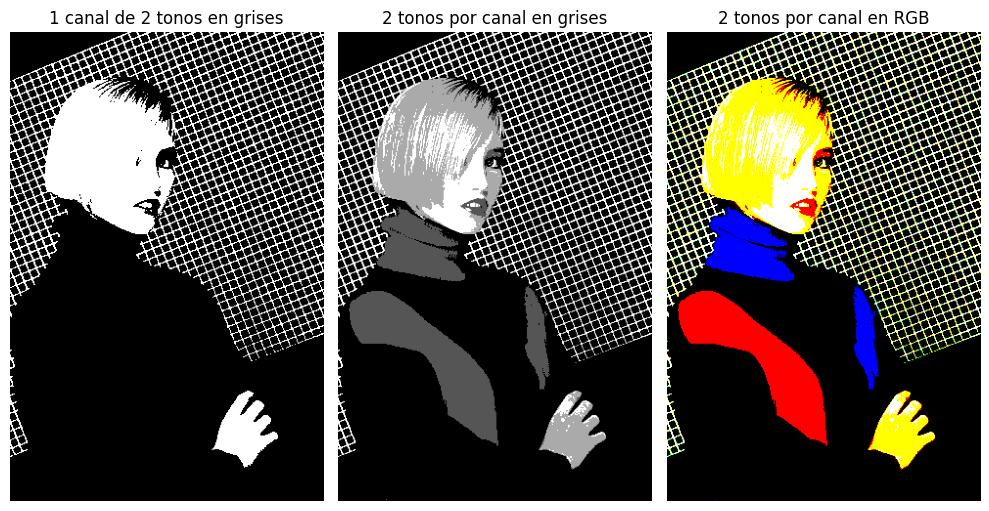

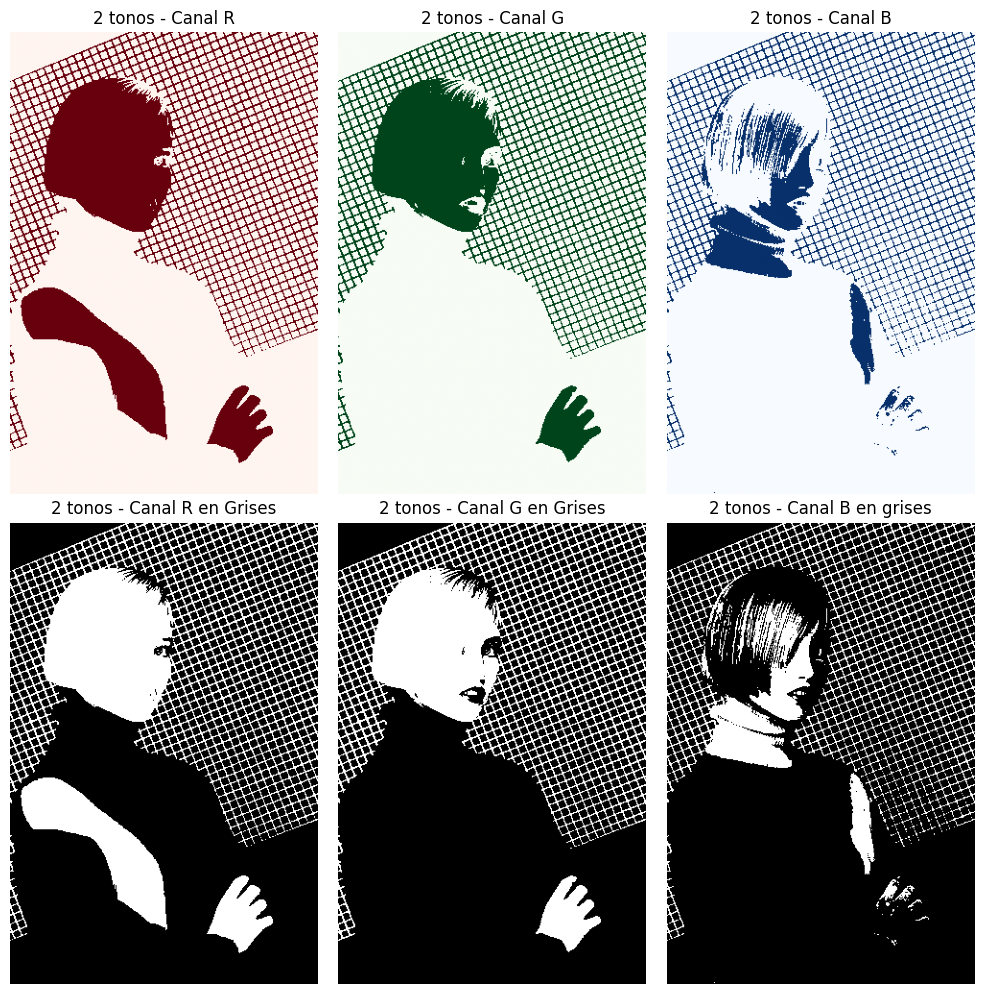

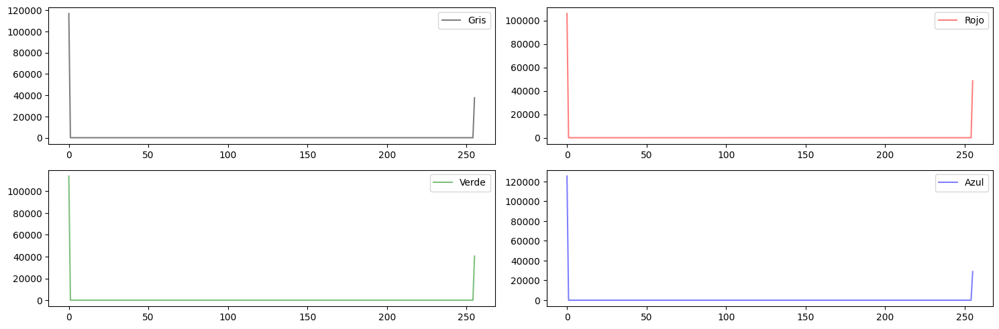

In [ ]:
#Creo una lista de tonos y muestro la imagen con cada opcion
lista_tonos=[256,128,64,32,16,8,4,2]
for tonos in lista_tonos:
    imagen_tonos=reduceCanales(imagen_original,tonos)
    print("\n###############################")
    print(f"  Imagen con {tonos} tonos      ")
    print("###############################\n")
    MuestraCanales(imagen_tonos,tonos)
